In [1]:
from torch.utils.data import DataLoader

In [2]:
import os
import wandb
import numpy as np
from IPython.display import clear_output
import seaborn as sns
from torchdiffeq import odeint
import torch
import torch.nn as nn
import torch.optim as optim
from torch.nn import functional as F
import matplotlib.pyplot as plt

In [3]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)
print("GPU Name:", torch.cuda.get_device_name(0))

In [4]:
wandb.login()

True

In [5]:
wandb.init(project="NODE_rnn", group="NODE_rnn",save_code=True,notes="Neural ODE RNN runs and evaluation")

In [6]:
def visualize(real=None, train=None, save=None, title=''):
    fig = plt.figure(figsize=(10,10))
    ax = fig.add_subplot(1, 1, 1, projection='3d')
    
    ax.set_title('Lorenz Attractor \n'+title)

    if train is not None:
      sns.set(style='darkgrid')
      
      z = np.array([o.detach().numpy() for o in train])
      z = np.reshape(z, [-1,3])
      sc = ax.scatter(z[:,0], z[:,1], z[:,2], c=z[:,2], cmap='Greens', s=1)
      #cbar = fig.colorbar(sc)

    if real is not None:
      #sns.set(style='darkgrid')
      
      z = np.array([o.detach().numpy() for o in real])
      z = np.reshape(z, [-1,3])
      ax.scatter(z[:,0], z[:,1], z[:,2], marker='.', color='k', alpha=0.5, linewidths=0, s=45)
      #sc = ax.scatter(z[:,0], z[:,1], z[:,2], c=z[:,2], cmap='Reds', s=1)
      #cbar = fig.colorbar(sc)
      #ax.scatter(, marker='.', c=c,cmap='viridis', alpha=0.5, linewidths=0, s=45)

    fig.canvas.draw()
    fig.canvas.flush_events()
    if save is not None:
        plt.savefig(save+'.png', format='png', dpi=400, bbox_inches ='tight', pad_inches = 0.1)
    plt.show()

In [7]:
class Lorenz(nn.Module):
    """
    chaotic lorenz system
    """
    def __init__(self):
        super(Lorenz, self).__init__()
        self.lin = nn.Linear(5, 3, bias=False)
        W = torch.tensor([[-10., 10., 0., 0., 0.],
                          [28., -1., 0., -1., 0.],
                          [0., 0., -8. / 3., 0., 1.]])
        self.lin.weight = nn.Parameter(W)

    def forward(self, t, x):
        y = y = torch.ones([1, 5])
        y[0][0] = x[0][0]
        y[0][1] = x[0][1]
        y[0][2] = x[0][2]
        y[0][3] = x[0][0] * x[0][2]
        y[0][4] = x[0][0] * x[0][1]
        return self.lin(y)

true_y0 = torch.tensor([[-8., 7., 27.]])  # initial condition
t = torch.linspace(0., 25., 5000)  # t is from 0 to 25 for 1000 data points

# generating training data
with torch.no_grad():
    data = odeint(Lorenz(), true_y0, t)

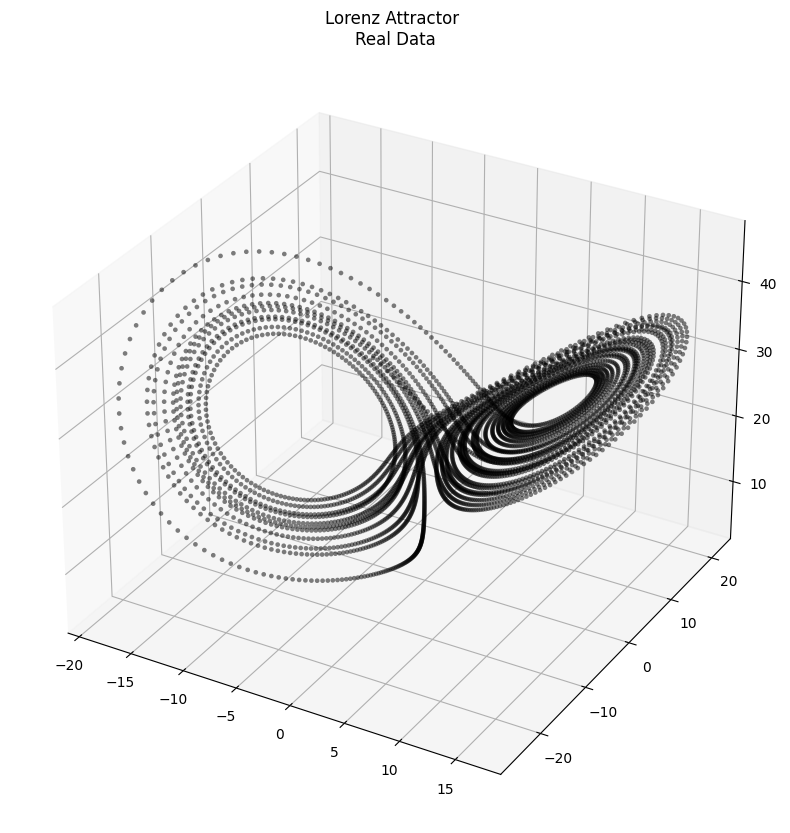

In [8]:
visualize(real=data,save='real',title='Real Data')

In [9]:
data.shape

torch.Size([5000, 1, 3])

In [10]:
t.shape

torch.Size([5000])

In [11]:
wandb_config = {
    'hidden_size': 512,
    'learning_rate': 1e-2,
    'batch_size': 50,
    'max_iterations': 1000,
}

# Initialize wandb configuration
wandb.config.update(wandb_config)

In [12]:
#sweep_id = wandb.sweep(sweep_path="sweep.yaml", project="NODE_rnn")

In [13]:
class LorenzTrain(nn.Module):
    """
    neural network for learning the chaotic lorenz system
    """
    def __init__(self):
        super(LorenzTrain, self).__init__()
        self.lin = nn.Linear(3, 512)
        self.lin3 = nn.Linear(512, 3)
        self.relu = nn.ReLU()

    def forward(self, t, x):
        x = self.relu(self.lin(x))
        x = self.lin3(x)
        return x
     

In [14]:
def get_batch(true_y, batch_size):
    num_samples = len(true_y)
    indices = np.random.choice(np.arange(num_samples - batch_size, dtype=np.int64), size=batch_size, replace=False)
    indices.sort()
    batch_y0 = true_y[indices]  # (batch_size, D)
    batch_t = t[:batch_size]  # (batch_size)
    batch_y = torch.stack([true_y[indices + i] for i in range(batch_size)], dim=0)  # (batch_size, M, D)
    return batch_y0, batch_t, batch_y

In [15]:
np.random.seed(7)

In [16]:

func = LorenzTrain().to(device)  # initializing Neural ODE
visualizer = visualize
optimizer = optim.Adam(func.parameters(), lr=1e-2)

In [17]:
data = data.to(device)

In [18]:
t = t.to(device)

In [19]:
#os.makedirs("PNG")

In [20]:
data[0]

tensor([[-8.,  7., 27.]], device='cuda:0')

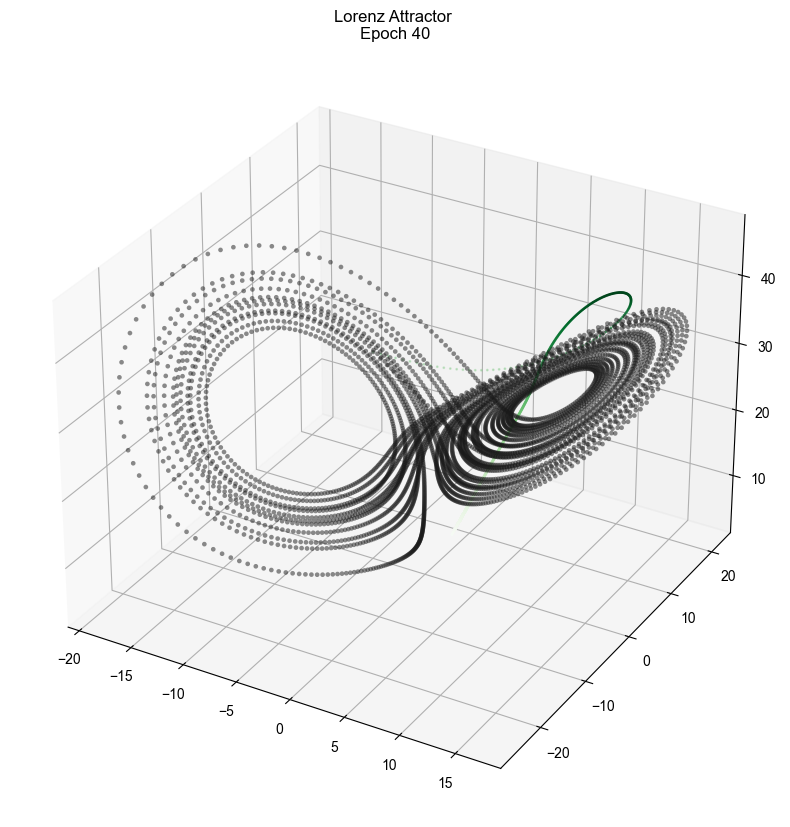

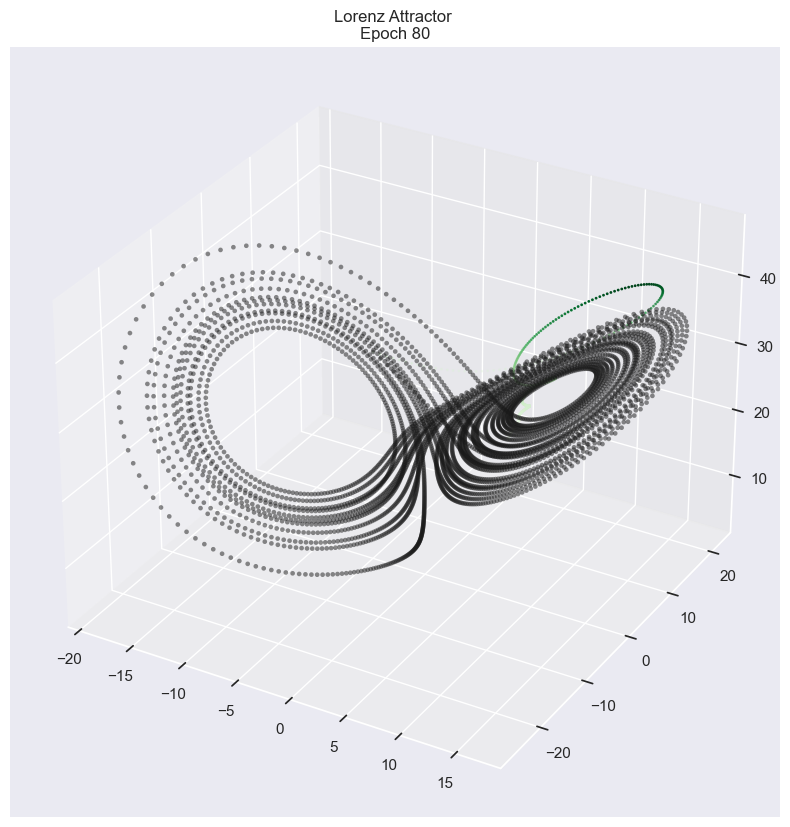

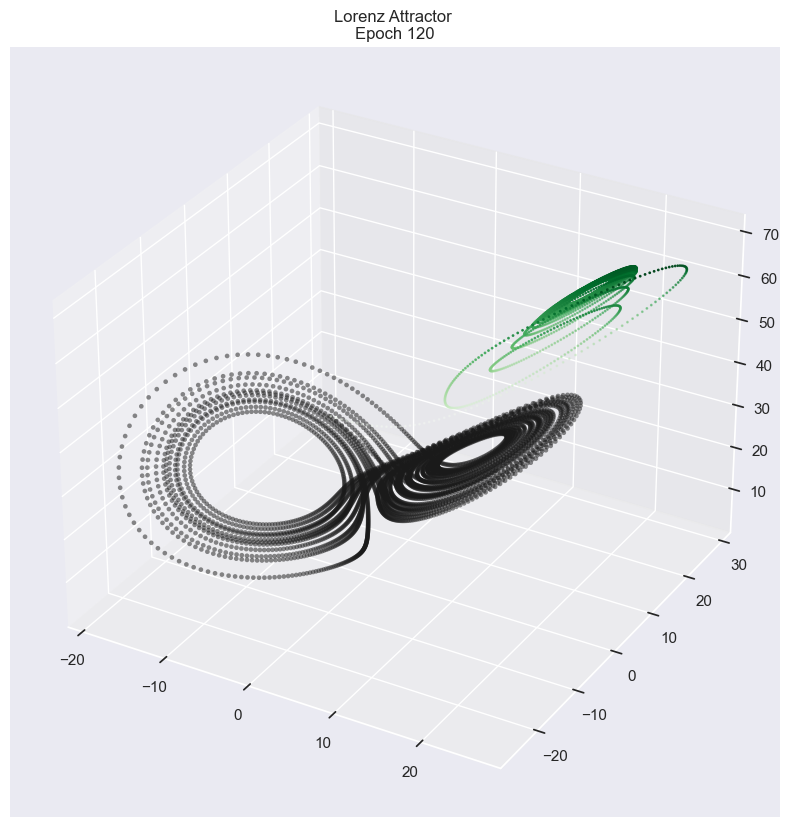

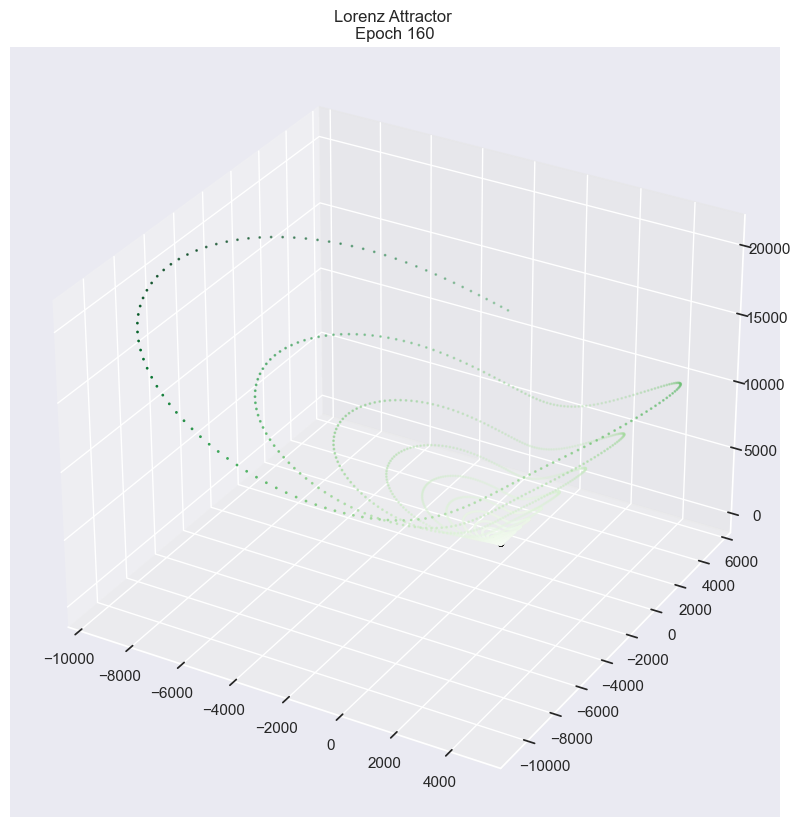

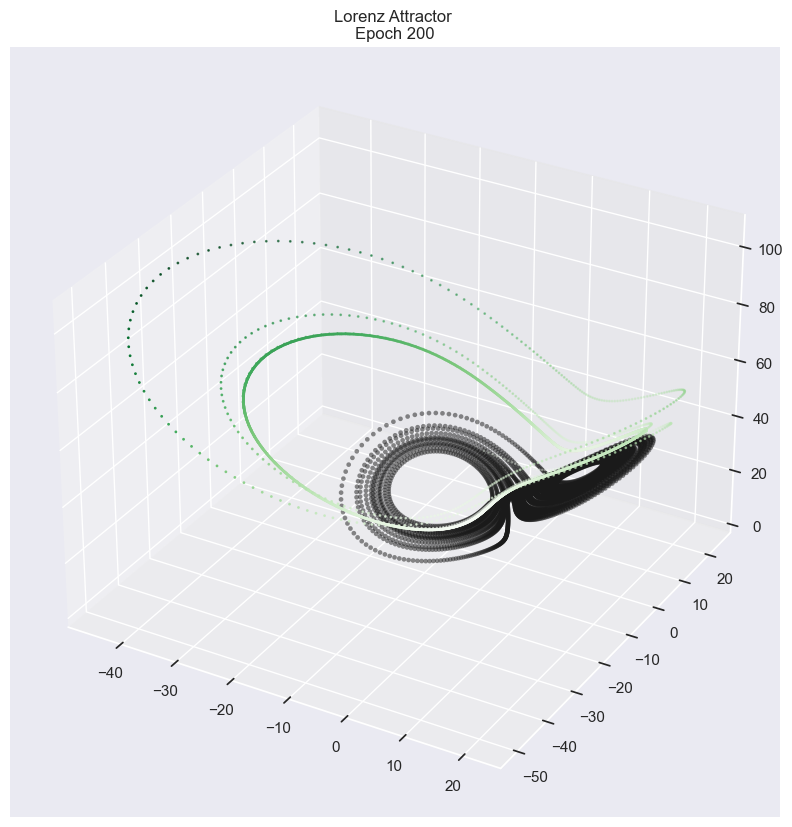

...

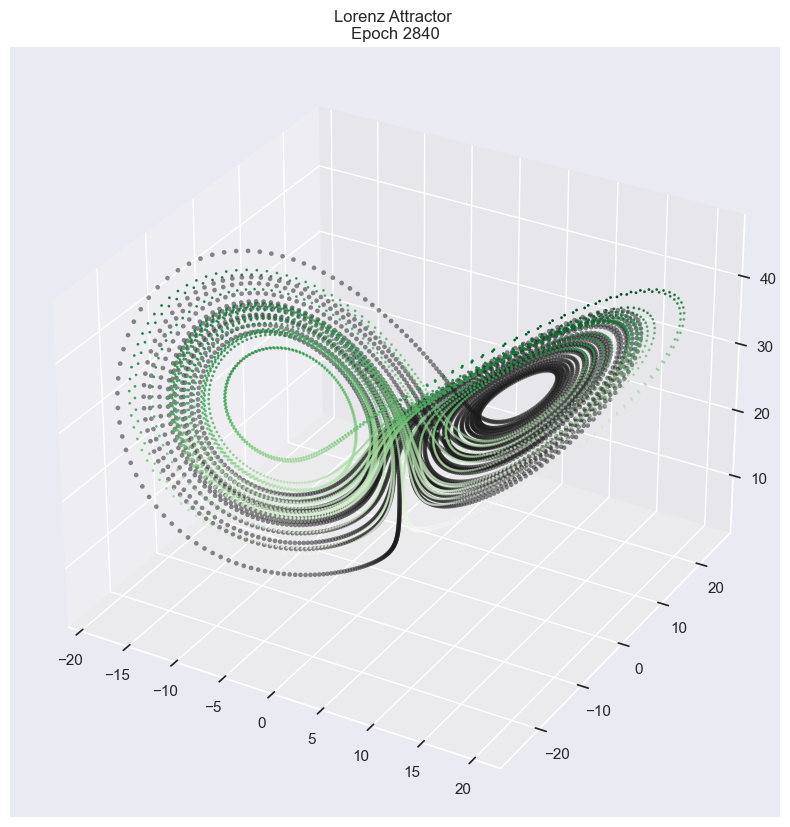

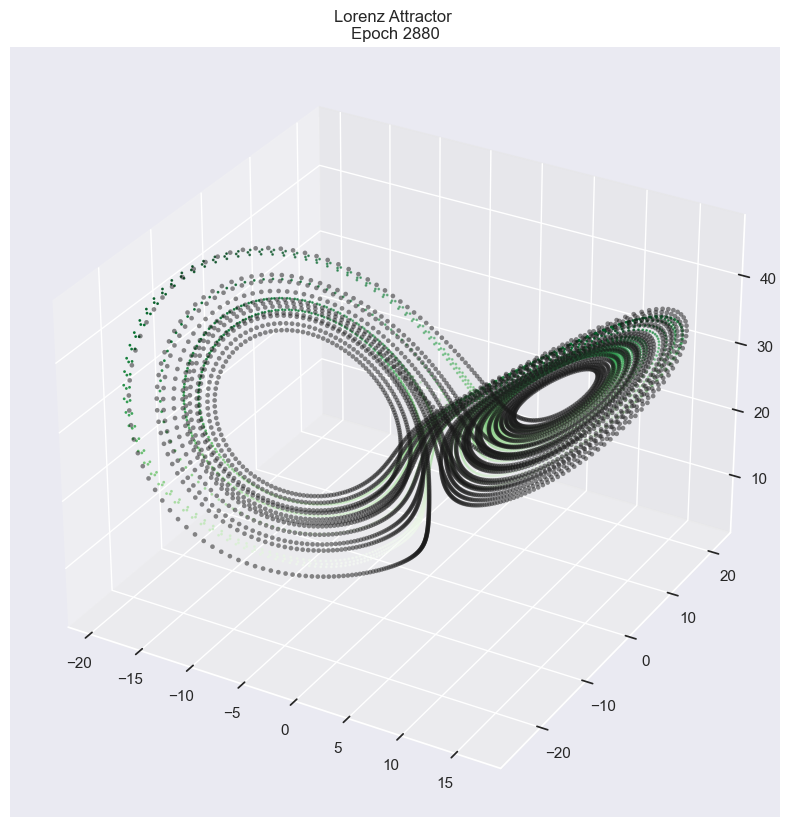

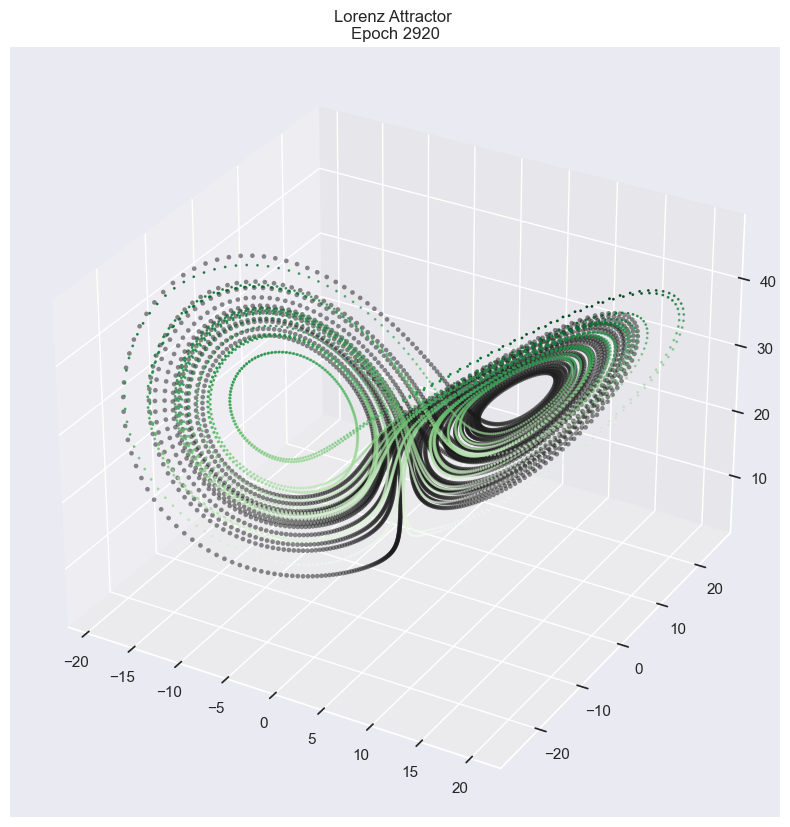

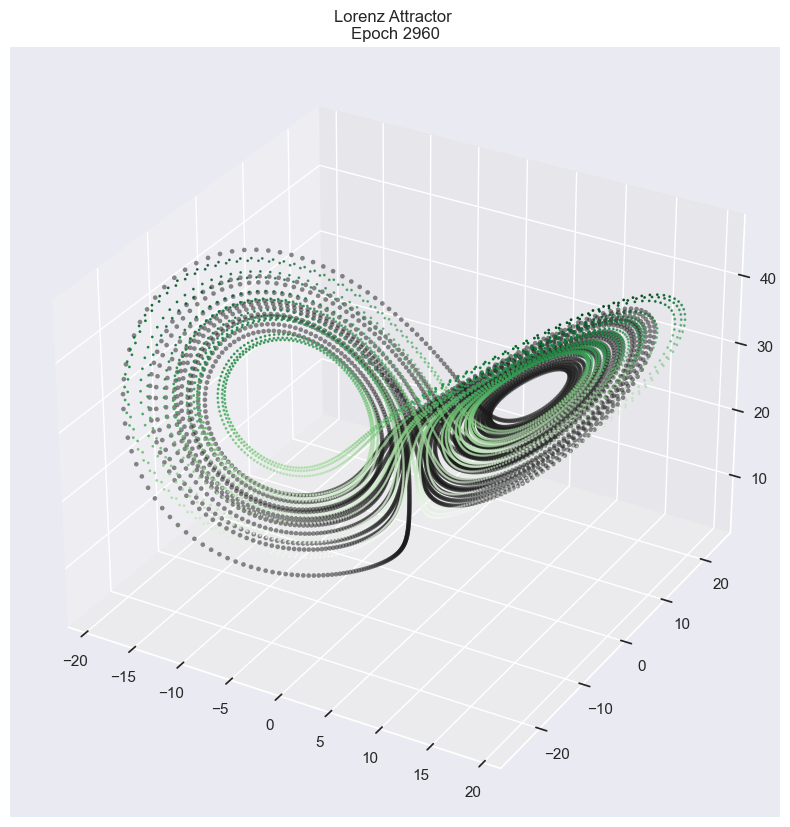

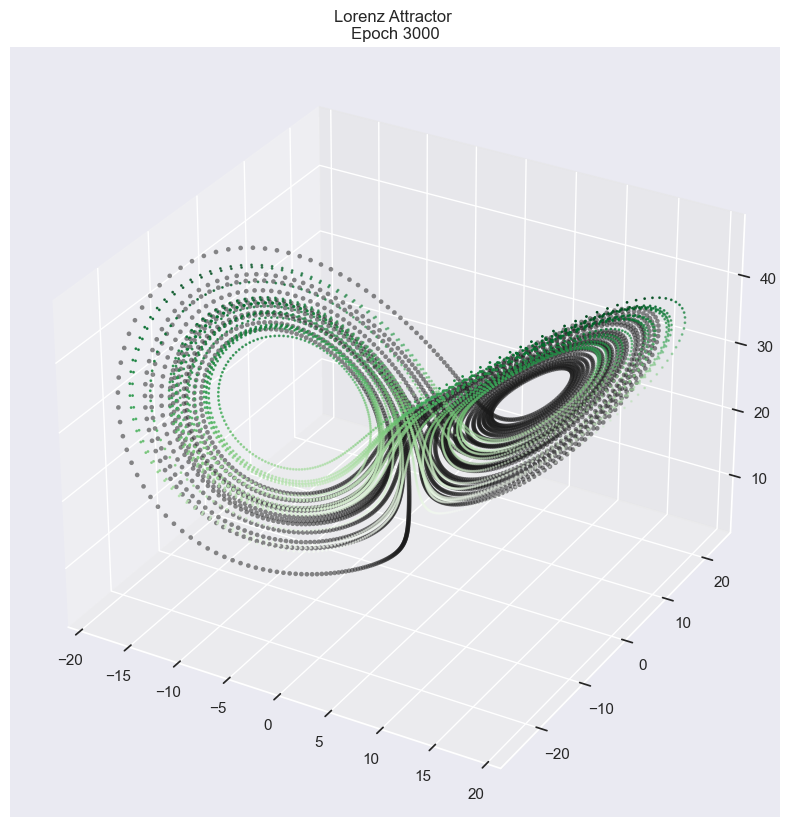

In [21]:
losses = []
whole_losses = []
best_loss = 1.0
for itr in range(1, 3000 + 1):
    optimizer.zero_grad()
    batch_y0, batch_t, batch_y = get_batch(data,50)  # getting trajectory batch
    pred_y = odeint(func, batch_y0, batch_t)  # prediction using batch initial condition and batch time stamps
    loss = F.mse_loss(pred_y, batch_y)
    loss.backward()
    optimizer.step()
    losses.append(loss.item())
    if loss.item() < best_loss:
                best_loss = loss.item()
                torch.save(func.state_dict(), 'saved_models/lorenz_node.pth')
    if itr % 40 == 0:
        if itr > 1800:
            optimizer.param_groups[0]['lr'] = 1e-3
        with torch.no_grad():
            pred_y = odeint(func, data[0], t)
            loss = F.mse_loss(pred_y, data)
            whole_losses.append(loss.item())
            visualize(real=data.cpu(), 
                             train=pred_y.cpu(),save='PNG/{}'.format(itr),title='Epoch {}'.format(itr))

            print('Iter {:04d} | Total Loss {:.6f}'.format(itr, loss.item()))
            clear_output(wait=True)

In [22]:
t_s = torch.linspace(0., 10., 1000)

In [23]:
t_s.shape

torch.Size([1000])

In [24]:
t.shape

torch.Size([5000])

In [25]:
data[0]

tensor([[-8.,  7., 27.]], device='cuda:0')

In [26]:
input_seq = data[0]

In [27]:
test_model = LorenzTrain().to(device)

In [28]:
test_model.load_state_dict(torch.load('saved_models\lorenz_node.pth'))

<All keys matched successfully>

In [29]:
# Generate a more accurate simulation using the learned dynamics
num_trajectories = 1  # Number of trajectories to simulate
trajectories = []
with torch.no_grad():
    
        # Sample a random initial point from the attractor
       

        # Propagate the initial point forward in time
    predicted_trajectory = odeint(test_model, data[0].to(device), t)
    trajectories.append(predicted_trajectory.cpu().numpy())
    
# Convert the tensors to NumPy arrays for plotting
trajectories_np = np.array(trajectories)

In [30]:
trajectories_np.shape

(1, 5000, 1, 3)

In [31]:
data.shape

torch.Size([5000, 1, 3])

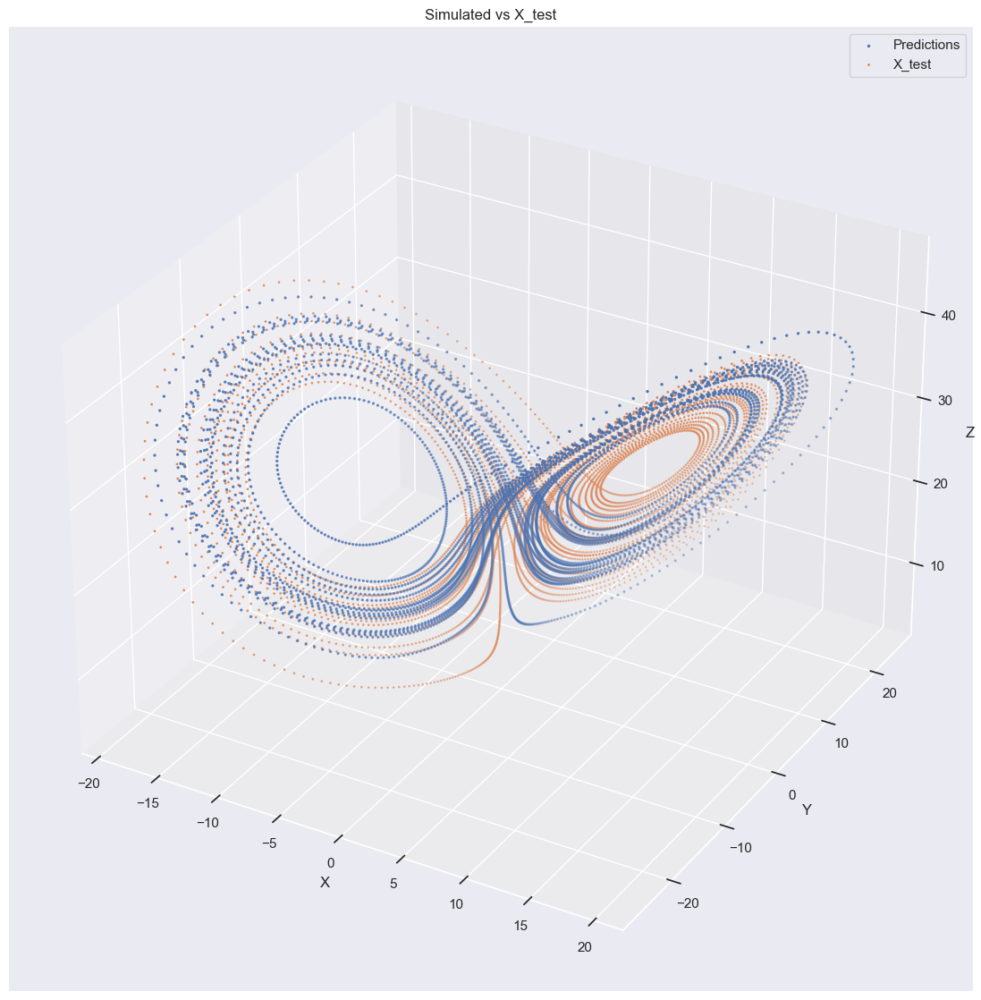

In [32]:
# Extract the x, y, z coordinates from predictions_plt
x_pred = trajectories_np[:,:, :, 0]
y_pred = trajectories_np[:,:, :, 1]
z_pred = trajectories_np[:,:, :, 2]

# Extract the x, y, z coordinates from X_train_plt
x_train = data[0:, :, 0].cpu()
y_train = data[ 0:, :, 1].cpu()
z_train = data[ 0:, :, 2].cpu()

# Create a 3D plot
fig = plt.figure(figsize=(14,14))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(x_pred, y_pred, z_pred, label='Predictions',s=2)
ax.scatter(x_train, y_train, z_train, label='X_test',s=1)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
ax.set_title('Simulated vs X_test')
ax.legend()

# Show the plot
plt.show()

In [33]:
x_pred[0,:,0].shape

(5000,)

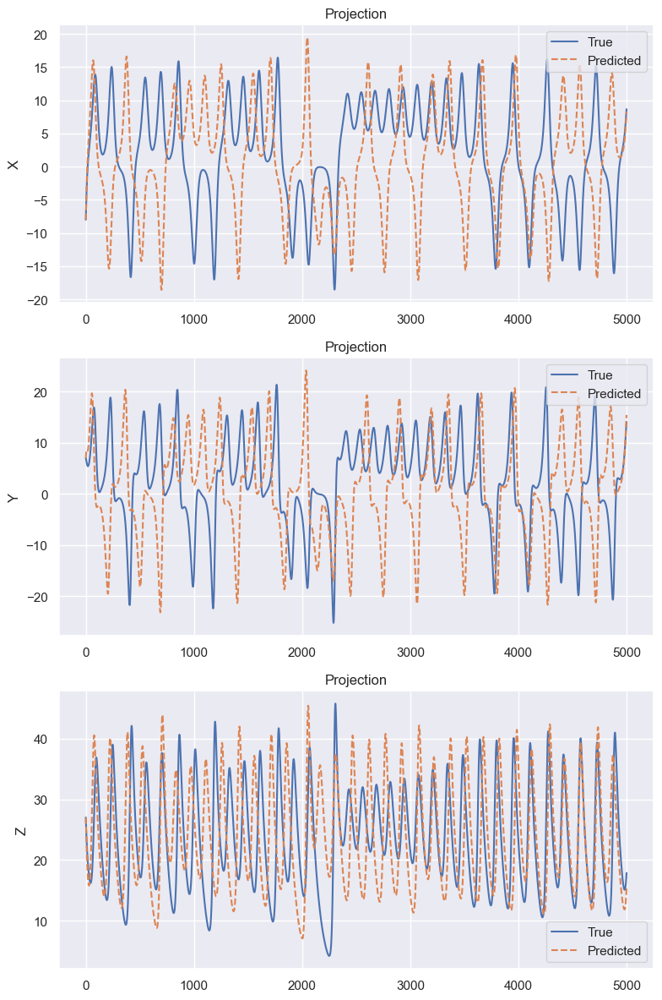

In [34]:
fig, ax = plt.subplots(3, 1, figsize=(8, 12))
ax[0].plot(x_train, label='True')
ax[0].plot(x_pred[0,:,0], label='Predicted',linestyle='--')
ax[0].set_ylabel('X')
#ax[0].set_xlim(0, 30)
ax[0].set_title('Projection')
ax[0].legend()

ax[1].plot(y_train, label='True')
ax[1].plot(y_pred[0,:,0], label='Predicted',linestyle='--')
ax[1].set_ylabel('Y')
ax[1].set_title('Projection')
ax[1].legend()

ax[2].plot(z_train, label='True')
ax[2].plot(z_pred[0,:,0], label='Predicted',linestyle='--')
ax[2].set_ylabel('Z')
#ax[2].set_xlim(0, 400)
ax[2].set_title('Projection')
ax[2].legend()

plt.tight_layout()
plt.show()

In [35]:
t_s = torch.linspace(0, 20, 2000)

In [36]:
t_s.shape

torch.Size([2000])

In [37]:
# Generate a more accurate simulation using the learned dynamics
num_trajectories = 1  # Number of trajectories to simulate
trajectories = []
with torch.no_grad():
    
        # Sample a random initial point from the attractor
       

        # Propagate the initial point forward in time
    predicted_trajectory = odeint(func, torch.tensor([[-8., 7., 27.]]).to(device), t_s)
    trajectories.append(predicted_trajectory.cpu().numpy())
    
# Convert the tensors to NumPy arrays for plotting
trajectories_np_extend = np.array(trajectories)

In [38]:
trajectories_np_extend.shape

(1, 2000, 1, 3)

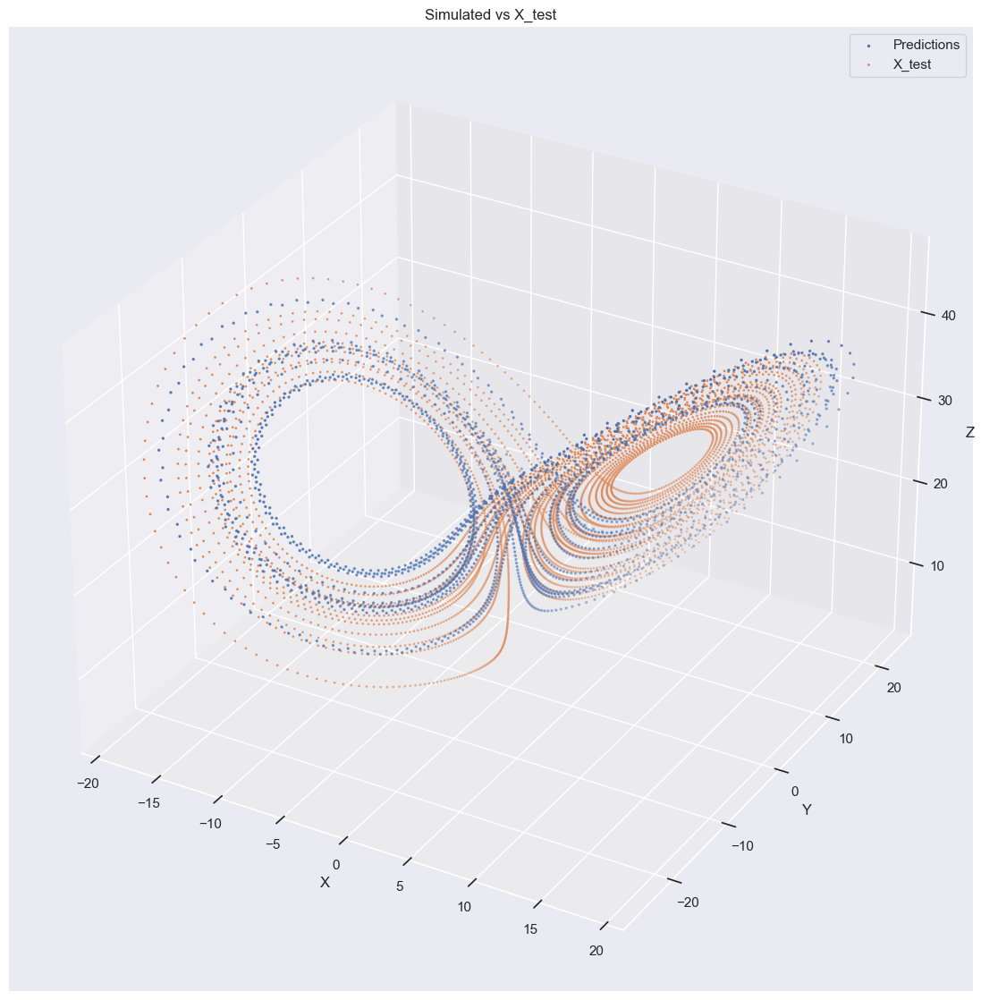

In [39]:
# Extract the x, y, z coordinates from predictions_plt
x_pred = trajectories_np_extend[:, :, :, 0]
y_pred = trajectories_np_extend[:, :, :, 1]
z_pred = trajectories_np_extend[:, :, :, 2]

# Extract the x, y, z coordinates from X_train_plt
x_train = data[0:, :, 0].cpu()
y_train = data[ 0:, :, 1].cpu()
z_train = data[ 0:, :, 2].cpu()

# Create a 3D plot
fig = plt.figure(figsize=(14,14))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(x_pred, y_pred, z_pred, label='Predictions',s=2)
ax.scatter(x_train, y_train, z_train, label='X_test',s=1)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
ax.set_title('Simulated vs X_test')
ax.legend()

# Show the plot
plt.show()

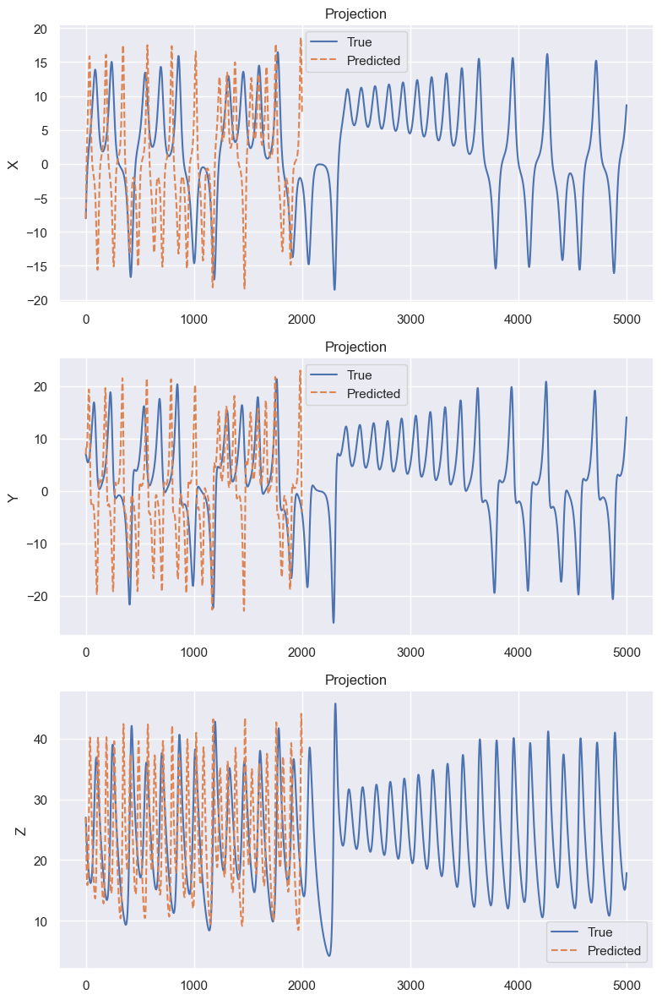

In [40]:
fig, ax = plt.subplots(3, 1, figsize=(8, 12))
ax[0].plot(x_train, label='True')
ax[0].plot(x_pred[0,:,0], label='Predicted',linestyle='--')
ax[0].set_ylabel('X')
#ax[0].set_xlim(0, 30)
ax[0].set_title('Projection')
ax[0].legend()

ax[1].plot(y_train, label='True')
ax[1].plot(y_pred[0,:,0], label='Predicted',linestyle='--')
ax[1].set_ylabel('Y')
ax[1].set_title('Projection')
ax[1].legend()

ax[2].plot(z_train, label='True')
ax[2].plot(z_pred[0,:,0], label='Predicted',linestyle='--')
ax[2].set_ylabel('Z')
#ax[2].set_xlim(0, 400)
ax[2].set_title('Projection')
ax[2].legend()

plt.tight_layout()
plt.show()

In [41]:
true_lorenz = data.to(device)

In [42]:
true_lorenz.shape

torch.Size([5000, 1, 3])

In [43]:
t[:10]

tensor([0.0000, 0.0050, 0.0100, 0.0150, 0.0200, 0.0250, 0.0300, 0.0350, 0.0400,
        0.0450], device='cuda:0')

In [44]:
k = data.size(0)

In [45]:
k

5000

In [46]:
# Extract the x variable from the Lorenz time series
x_vars =[]
for i in range(0, k-2, 1):
    x_t_2 = true_lorenz[i, 0]
    x_t_1 = true_lorenz[i+1,0]
    x_t_ = true_lorenz[i+2, 0]
    x_vars.append(torch.stack((x_t_2, x_t_1, x_t_)))
x_vars = torch.stack(x_vars).to(device)

In [47]:
true_lorenz[0:7]

tensor([[[-8.0000,  7.0000, 27.0000]],

        [[-7.2703,  6.9152, 26.3785]],

        [[-6.5808,  6.8147, 25.7929]],

        [[-5.9300,  6.7033, 25.2413]],

        [[-5.3167,  6.5853, 24.7214]],

        [[-4.7390,  6.4642, 24.2310]],

        [[-4.1955,  6.3429, 23.7680]]], device='cuda:0')

In [48]:
x_vars.shape

torch.Size([4998, 3, 3])

In [49]:
x_only = LorenzTrain().to(device)  # initializing Neural ODE
visualizer = visualize
optimizer = optim.Adam(x_only.parameters(), lr=1e-3)

In [50]:
pred_y = odeint(x_only, data[0], t)

In [51]:
train_data = true_lorenz

In [52]:
from torchdiffeq import odeint_adjoint

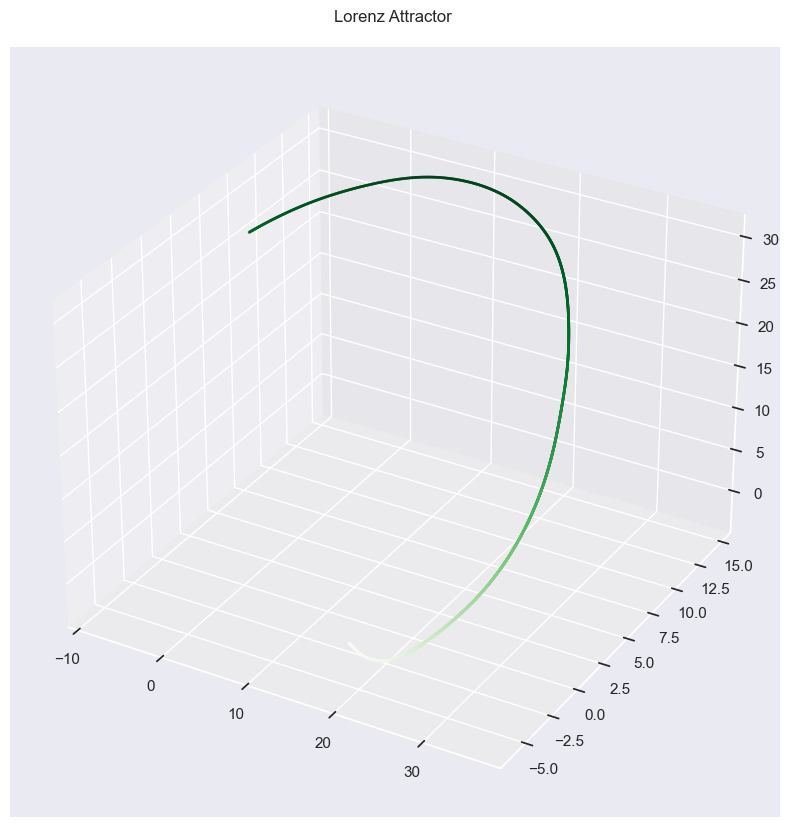

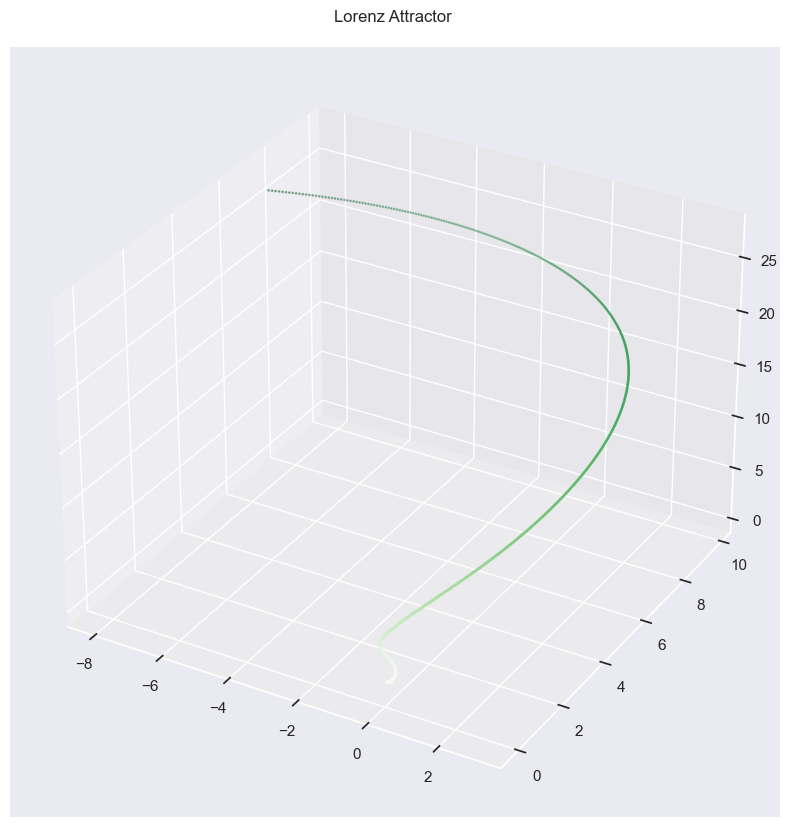

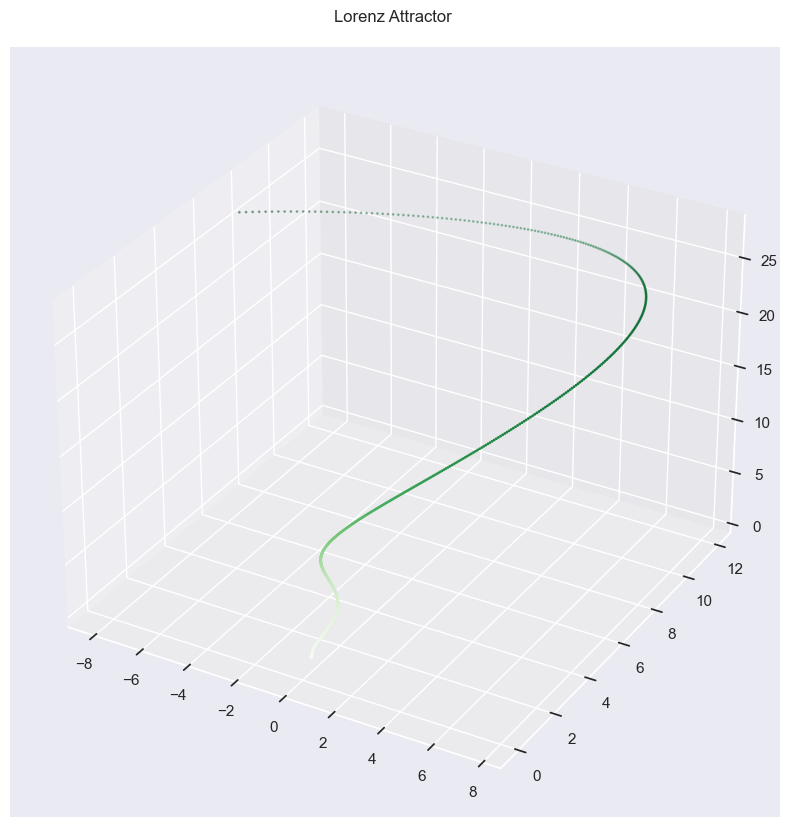

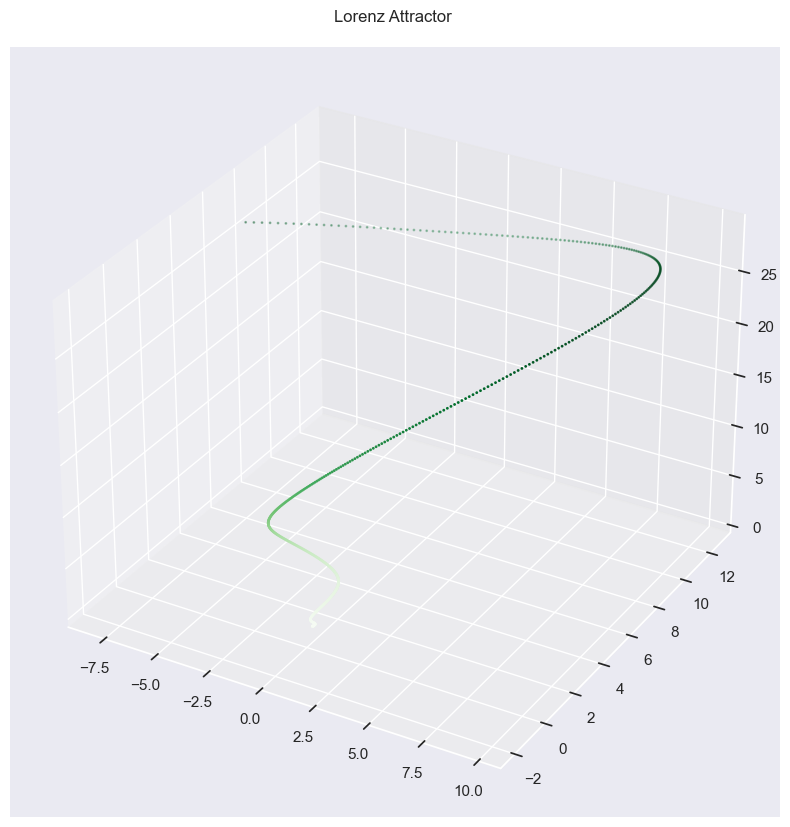

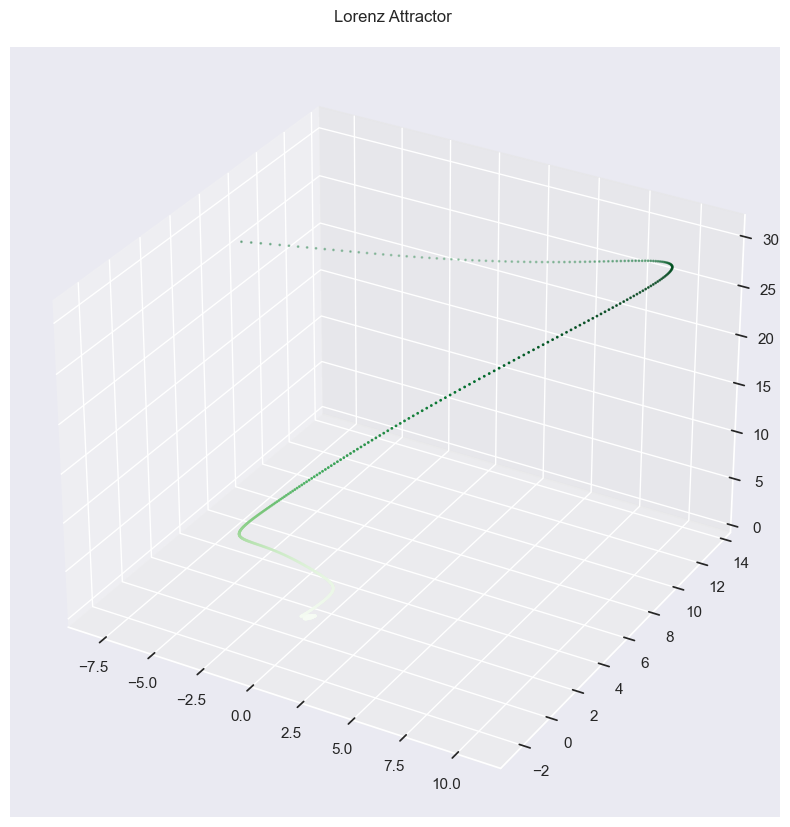

...

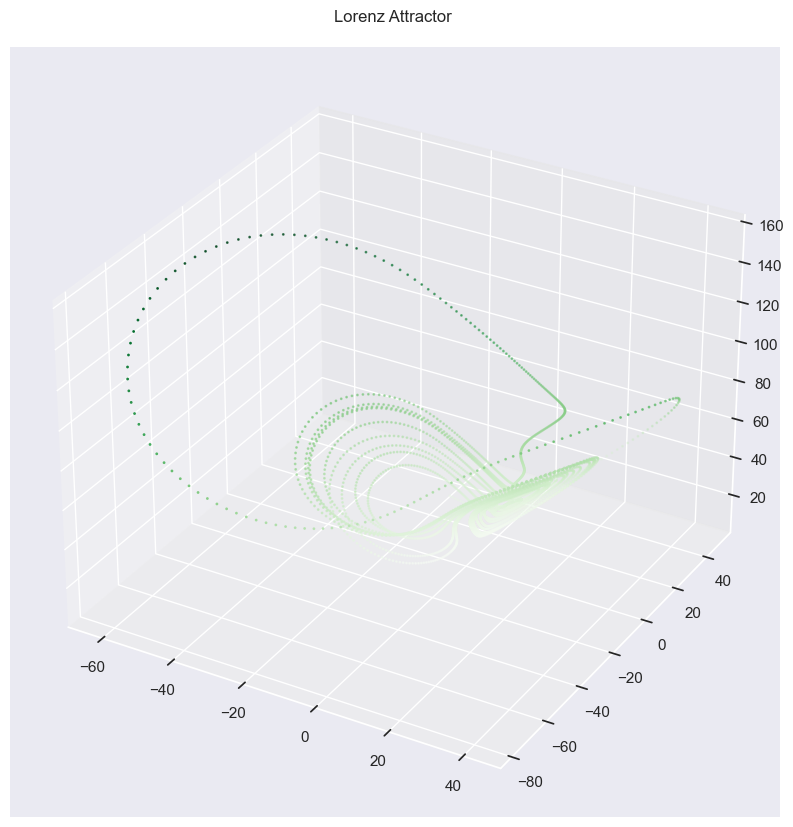

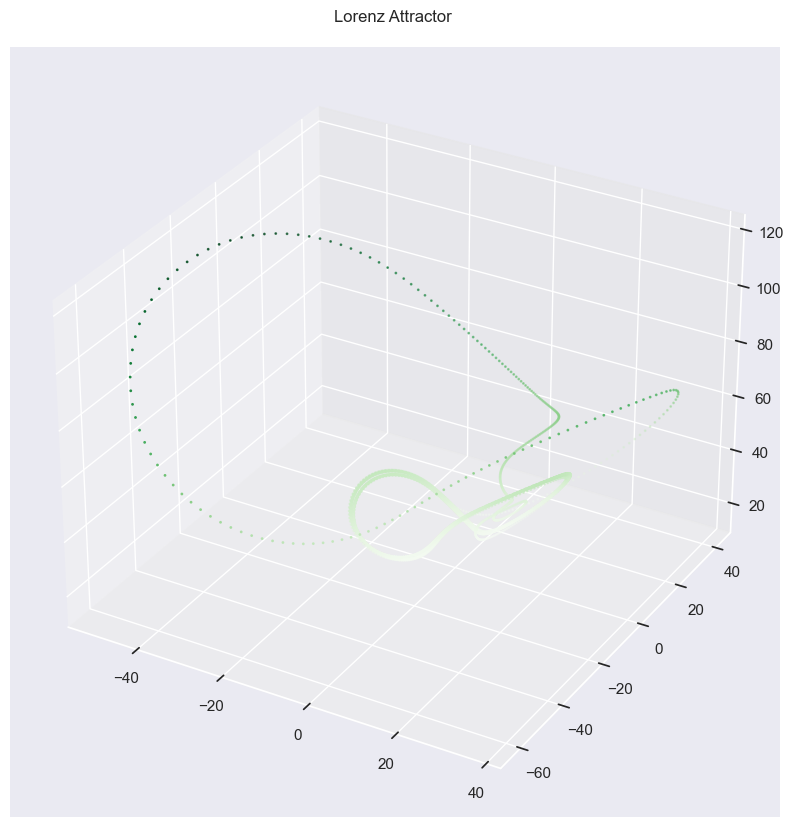

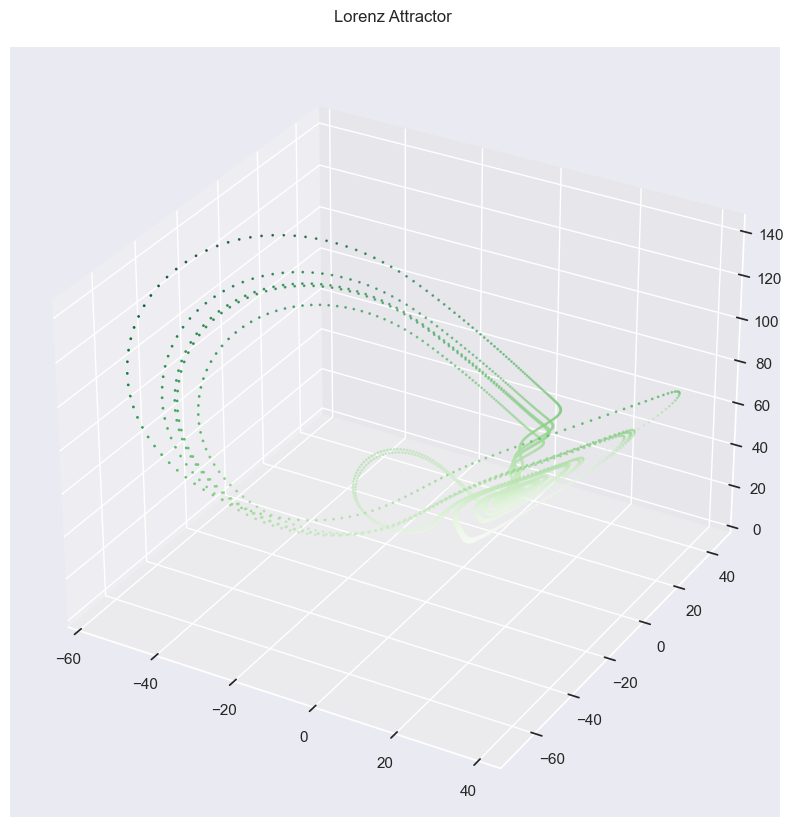

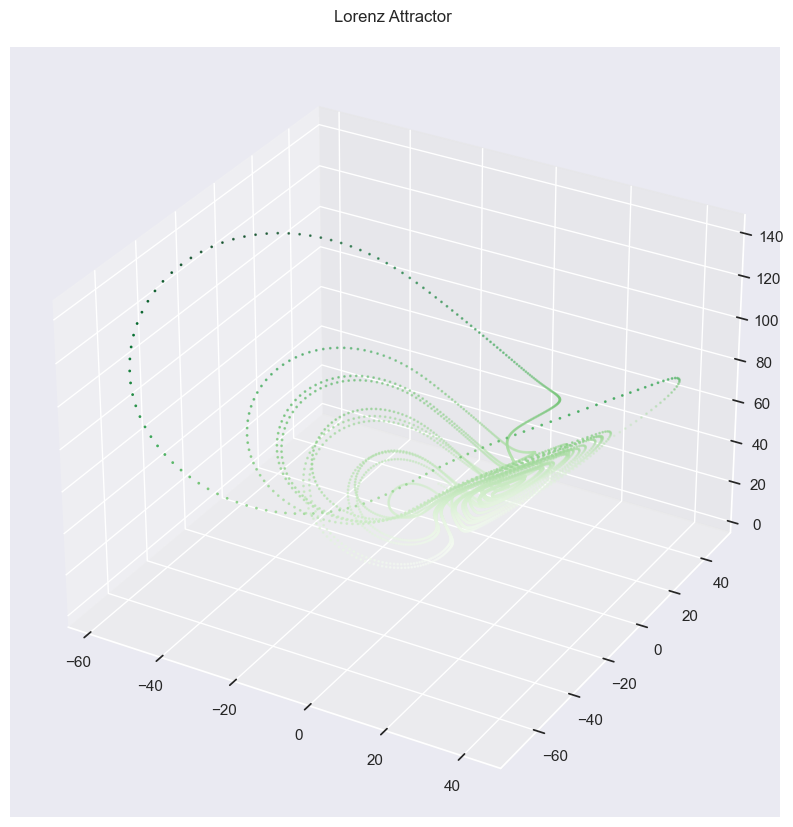

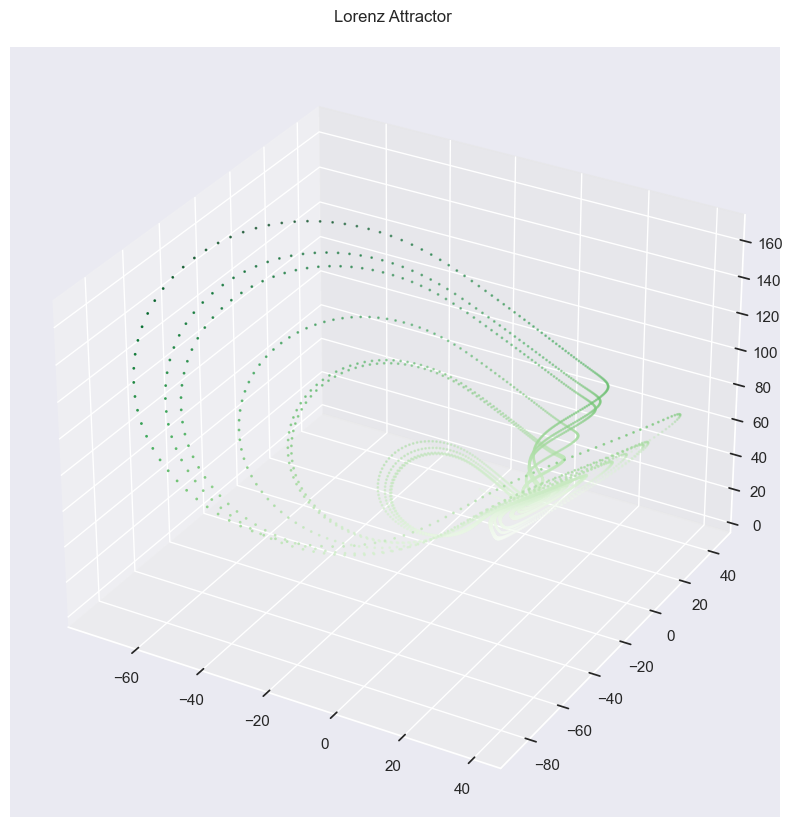

In [53]:
for itr in range(3000):
    optimizer.zero_grad()
    batch_y0, batch_t, batch_y = get_batch(x_vars, 25)

    pred_y = odeint(x_only, batch_y0, batch_t)
    loss = F.mse_loss(pred_y, batch_y)
    loss.backward()
    optimizer.step()

    if itr % 40 == 0:
        if itr > 500:
            optimizer.param_groups[0]['lr'] = 1e-3
        with torch.no_grad():
            pred_y = odeint(x_only, train_data[0], t)
            loss = F.mse_loss(pred_y, train_data)
            

            visualize(train=pred_y.cpu())

            # Log metrics to wandb
            wandb.log({'Iteration': itr, 'Loss': loss.item()})
            print('Iter {:04d} | Total Loss {:.6f}'.format(itr, loss.item()))
            clear_output(wait=True)

In [54]:
# Generate a more accurate simulation using the learned dynamics
num_trajectories = 1  # Number of trajectories to simulate
trajectories = []
with torch.no_grad():
    
        # Sample a random initial point from the attractor
       

        # Propagate the initial point forward in time
    predicted_trajectory = odeint(x_only.cpu(), torch.tensor([[-8., 7., 27.]]), t.cpu())
    trajectories.append(predicted_trajectory.cpu().numpy())
    
# Convert the tensors to NumPy arrays for plotting
trajectories_np_extend = np.array(trajectories)

In [55]:
train_data.shape

torch.Size([5000, 1, 3])

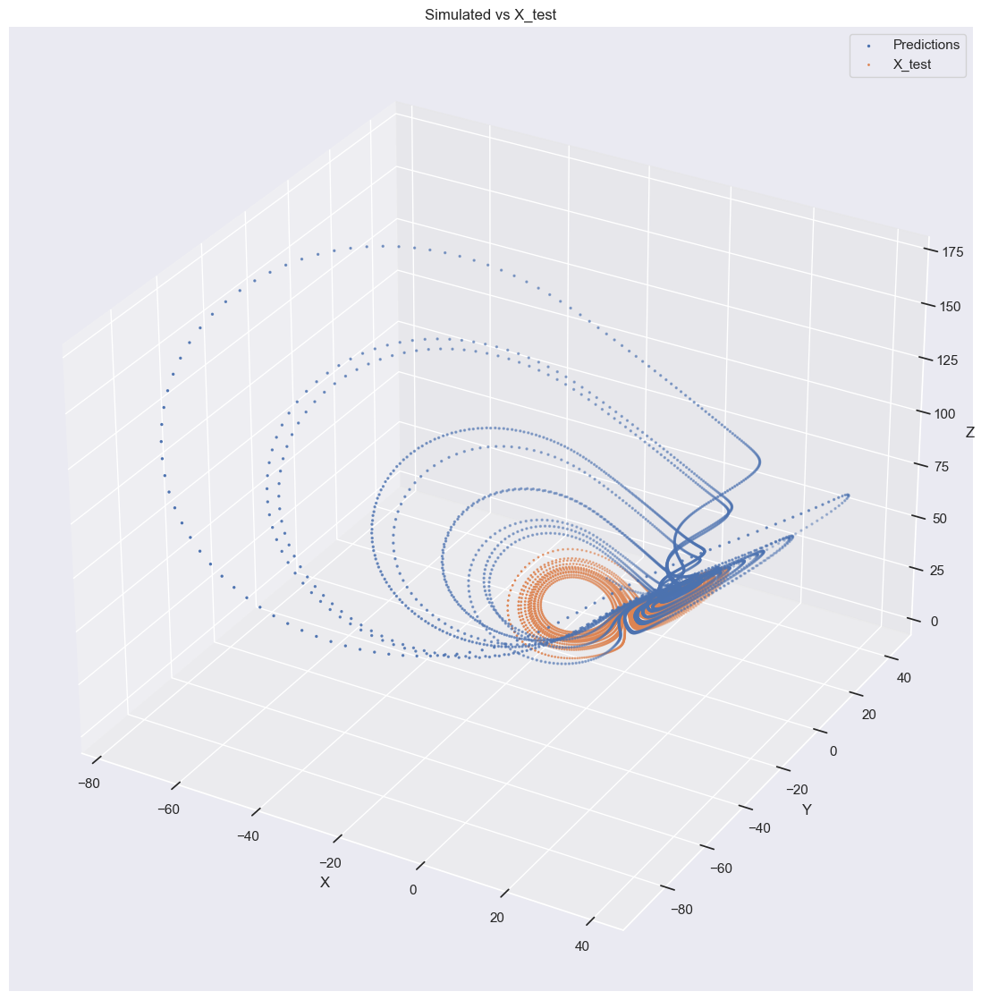

In [56]:
# Extract the x, y, z coordinates from predictions_plt
x_pred = trajectories_np_extend[:, 0:, :, 0]
y_pred = trajectories_np_extend[:, 0:, :, 1]
z_pred = trajectories_np_extend[:, 0:, :, 2]

# Extract the x, y, z coordinates from X_train_plt
x_train = train_data[:,:, 0].cpu()
y_train = train_data[ :, :, 1].cpu()
z_train = train_data[ :, :,2].cpu()

# Create a 3D plot
fig = plt.figure(figsize=(14,14))
ax = fig.add_subplot(111, projection='3d')
ax.scatter(x_pred, y_pred, z_pred, label='Predictions',s=2)
ax.scatter(x_train, y_train, z_train, label='X_test',s=1)
ax.set_xlabel('X')
ax.set_ylabel('Y')
ax.set_zlabel('Z')
ax.set_title('Simulated vs X_test')
ax.legend()

# Show the plot
plt.show()

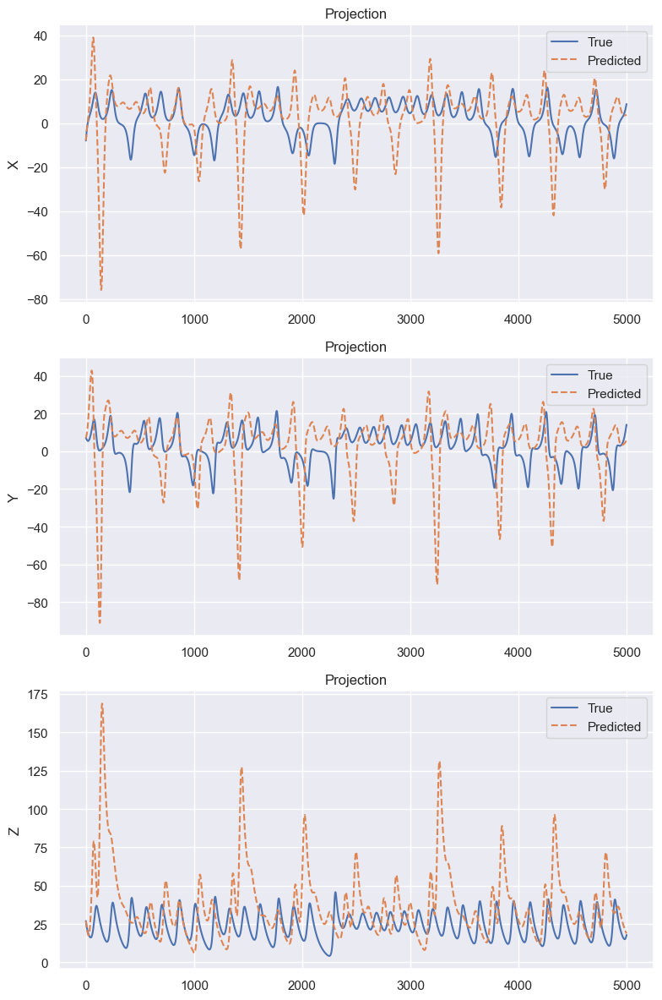

In [57]:
fig, ax = plt.subplots(3, 1, figsize=(8, 12))
ax[0].plot(x_train, label='True')
ax[0].plot(x_pred[0,:,0], label='Predicted',linestyle='--')
ax[0].set_ylabel('X')

ax[0].set_title('Projection')
ax[0].legend()

ax[1].plot(y_train, label='True')
ax[1].plot(y_pred[0,:,0], label='Predicted',linestyle='--')
ax[1].set_ylabel('Y')
ax[1].set_title('Projection')
ax[1].legend()

ax[2].plot(z_train, label='True')
ax[2].plot(z_pred[0,:,0], label='Predicted',linestyle='--')
ax[2].set_ylabel('Z')
#ax[2].set_xlim(0, 400)
ax[2].set_title('Projection')
ax[2].legend()

plt.tight_layout()
plt.show()

In [58]:
from torch.utils.data import DataLoader

In [59]:
import os
import wandb
import numpy as np
from IPython.display import clear_output
import seaborn as sns
from torchdiffeq import odeint
import torch
import torch.nn as nn
import torch.optim as optim
from torch.nn import functional as F
import matplotlib.pyplot as plt

In [60]:
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Using device:", device)
print("GPU Name:", torch.cuda.get_device_name(0))

In [61]:
wandb.login()

True

In [62]:
wandb.init(project="NODE_rnn", group="NODE_rnn",save_code=True,notes="Neural ODE RNN runs and evaluation")